In [51]:
%reload_ext autoreload
%autoreload 2

import sys
import numpy as np
np.set_printoptions(precision=4, suppress=True)
KITTI_ROOT_PATH = '/home/ruizhu/Documents/Datasets/kitti'
KITTI_PATH = KITTI_ROOT_PATH + '/raw'

sys.path.append(KITTI_ROOT_PATH+'/kitti-lidar-utils')
sys.path.append(KITTI_ROOT_PATH+'/kitti-lidar-utils/source')
sys.path.append(KITTI_ROOT_PATH+'/depth/devkit/python')
import itertools
import pdb
import pykitti  # install using pip install pykitti
import os
from PIL import Image, ImageOps
import imageio
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import time
from source.utils import load_tracklets_for_frames, point_inside, in_hull
from source import parseTrackletXML as xmlParser
from source.kitti_util import *
import argparse
from matplotlib import cm
# from cluster_pcs.filters import *
from math import atan2, degrees
from PIL import Image
from read_depth import *
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

import torch

## Select sequence
date_name = '2011_09_26'
seq_name = '_drive_0005_sync'
tracklet_path = KITTI_PATH+'/%s/%s/tracklet_labels.xml'%(date_name, date_name+seq_name)
fdir_path = KITTI_PATH+'/%s/%s/'%(date_name, date_name+seq_name)
if os.path.exists(tracklet_path):
    print('======Tracklet Exists:', tracklet_path)
else:
    print('======Tracklet NOT Exists:', tracklet_path)
    
## Raw Data directory information
path = fdir_path.rstrip('/')
basedir = path.rsplit('/',2)[0]
date = path.split('/')[-2]
drive = path.split('/')[-1].split('_')[-2]

dataset = pykitti.raw(basedir, date, drive)
tracklet_rects, tracklet_types, tracklet_ids, tracklet_Rs, tracklet_ts = load_tracklets_for_frames(len(list(dataset.velo)),\
               '{}/{}/{}_drive_{}_sync/tracklet_labels.xml'.format(basedir,date, date, drive)) # (3, 3) (3,)
dataset_gray = list(dataset.gray)
dataset_rgb = list(dataset.rgb) 

## From Rui
# Understanding calibs: https://github.com/utiasSTARS/pykitti/blob/0e5fd7fefa7cd10bbdfb5bd131bb58481d481116/pykitti/raw.py#L150
cam = 'leftRGB'
P_rects = {'leftRGB':dataset.calib.P_rect_20, 'rightRGB':dataset.calib.P_rect_30} # cameras def.: https://github.com/utiasSTARS/pykitti/blob/19d29b665ac4787a10306bbbbf8831181b38eb38/pykitti/odometry.py#L42
cam2cam = {}
R_cam2rect = dataset.calib.R_rect_00 # [cam0] R_rect_xx: 3x3 rectifying rotation to make image planes co-planar
P_rect = P_rects['leftRGB'] # P_rect_0[0-3]: 3x4 projection matrix after rectification; the reprojection matrix in MV3D
velo2cam = dataset.calib.T_cam0_velo_unrect
P_velo2im = np.dot(np.dot(P_rect, R_cam2rect), velo2cam) # 4*3

## Help functions and plot params
fig_scale = 300
fig_ratio = [4, 3]
im_shape = [375, 1242]

# https://github.com/vcg-uvic/learned-correspondence-release/blob/16bef8a0293c042c0bd42f067d7597b8e84ef51a/network.py#L160
def torch_skew_symmetric(v): # v: [3, 1]
    zero = torch.zeros_like(v[0, 0])
    M = torch.stack([
        zero, -v[2, 0], v[1, 0],
        v[2, 0], zero, -v[0, 0],
        -v[1, 0], v[0, 0], zero,
    ], dim=0)
    return torch.reshape(M, (3, 3))

def within(x, y, xlim, ylim):
    val_inds = (x >= 0) & (y >= 0)
    val_inds = val_inds & (x < xlim) & (y < ylim)
    return val_inds

def scatter_xy(xy, c, im_shape, title='', new_figure=True):
    if new_figure:
        plt.figure(figsize=(30, 8))
    plt.scatter(xy[:, 0], xy[:, 1], s=2, c=c, cmap='rainbow')
    plt.colorbar()
    plt.xlim(0, im_shape[1]-1)
    plt.ylim(im_shape[0]-1, 0)
    plt.title(title)
    plt.show()
    val_inds = within(xy[:, 0], xy[:, 1], im_shape[1], im_shape[0])
    return val_inds

def homo_th(x):
    # input: x [N, 2]
    # output: x_homo [N, 3]
    N = list(x.size())[0]
    x_homo = torch.cat((x, torch.ones(N, 1, dtype=x.dtype)), 1)
    return x_homo

def de_homo_th(x_homo):
    # input: x_homo [N, 3]
    # output: x [N, 2]
    N = list(x_homo.size())[0]
    epi = 1e-10
    x = torch.cat((x_homo[:, 0:1]/(x_homo[:, 2:3]+epi), x_homo[:, 1:2]/(x_homo[:, 2:3]+epi)), 1)
    return x

def homo_np(x):
    # input: x [N, D]
    # output: x_homo [N, D+1]
    N = x.shape[0]
    x_homo = np.hstack((x, np.ones((N, 1))))
    return x_homo

def de_homo_np(x_homo):
    # input: x_homo [N, D]
    # output: x [N, D-1]
    N = x_homo.shape[0]
    epi = 1e-10
    x = np.hstack((x_homo[:, 0:1]/(x_homo[:, 2:3]+epi), x_homo[:, 1:2]/(x_homo[:, 2:3]+epi)))
    return x

======Tracklet Exists: /home/ruizhu/Documents/Datasets/kitti/raw/2011_09_26/2011_09_26_drive_0005_sync/tracklet_labels.xml
Parsing tracklet file /home/ruizhu/Documents/Datasets/kitti/raw/2011_09_26/2011_09_26_drive_0005_sync/tracklet_labels.xml
File contains 15 tracklets
Loaded 15 tracklets.


In [94]:
%reload_ext autoreload
%autoreload 2
from kitti_tools.kitti_raw_loader import *

import glob
drive = KITTI_PATH+'/%s/%s'%(date_name, date_name+seq_name)
oxts_path = drive+'/oxts/data/*.txt'
oxts = sorted(glob.glob(oxts_path))
# print(oxts)

scene_data = {'cid': '', 'dir': drive, 'speed': [], 'frame_id': [], 'pose':[], 'rel_path': ''}
scale = None
origin = None
imu2velo_dict = read_calib_file(drive+'/../calib_imu_to_velo.txt')
velo2cam_dict = read_calib_file(drive+'/../calib_velo_to_cam.txt')
cam2cam_dict = read_calib_file(drive+'/../calib_cam_to_cam.txt')

velo2cam_mat = transform_from_rot_trans(velo2cam_dict['R'], velo2cam_dict['T'])
imu2velo_mat = transform_from_rot_trans(imu2velo_dict['R'], imu2velo_dict['T'])
cam_2rect_mat = transform_from_rot_trans(cam2cam_dict['R_rect_00'], np.zeros(3))

imu2cam = cam_2rect_mat @ velo2cam_mat @ imu2velo_mat
for n, f in enumerate(oxts):
    metadata = np.genfromtxt(f)
    speed = metadata[8:11]
    scene_data['speed'].append(speed)
    scene_data['frame_id'].append('{:010d}'.format(n))
    lat = metadata[0]

    if scale is None:
        scale = np.cos(lat * np.pi / 180.)

    pose_matrix = pose_from_oxts_packet(metadata[:6], scale)
    if origin is None:
        origin = pose_matrix

    odo_pose = imu2cam @ np.linalg.inv(origin) @ pose_matrix @ np.linalg.inv(imu2cam)
    odo_pose_Rt = odo_pose[:3]
    R21 = odo_pose_Rt[:, :3]
    t21 = odo_pose_Rt[:, 3:4]
    R12 = R21.T
    t12 = -np.matmul(R12, t21)
    Rt12 = np.hstack((R12, t12))
#     Rt1 = np.hstack((odo_pose_Rt[:, :3].T, -odo_pose_Rt[:, 3:4]))
    scene_data['pose'].append(Rt12)
    
print(scene_data['pose'])

[array([[ 1., -0.,  0., -0.],
       [ 0.,  1., -0.,  0.],
       [ 0., -0.,  1.,  0.]]), array([[ 0.9999,  0.0005,  0.0157,  0.0088],
       [-0.0005,  1.    , -0.0046,  0.0056],
       [-0.0157,  0.0046,  0.9999, -0.3428]]), array([[ 0.9996,  0.0009,  0.028 ,  0.0003],
       [-0.0005,  0.9999, -0.0154,  0.0185],
       [-0.028 ,  0.0154,  0.9995, -0.6627]]), array([[ 0.9992, -0.0021,  0.0404, -0.0269],
       [ 0.0031,  0.9997, -0.0235,  0.0465],
       [-0.0403,  0.0236,  0.9989, -0.9918]]), array([[ 0.9985, -0.0022,  0.0543, -0.0676],
       [ 0.0035,  0.9997, -0.0241,  0.0755],
       [-0.0542,  0.0242,  0.9982, -1.3382]]), array([[ 0.9978, -0.003 ,  0.0669, -0.0833],
       [ 0.0045,  0.9997, -0.0219,  0.0941],
       [-0.0668,  0.0222,  0.9975, -1.6367]]), array([[ 0.9968, -0.0003,  0.0793, -0.0974],
       [ 0.002 ,  0.9998, -0.0207,  0.1008],
       [-0.0793,  0.0208,  0.9966, -1.9147]]), array([[ 0.9957, -0.0014,  0.0927, -0.1127],
       [ 0.003 ,  0.9998, -0.0172,  0.0986]

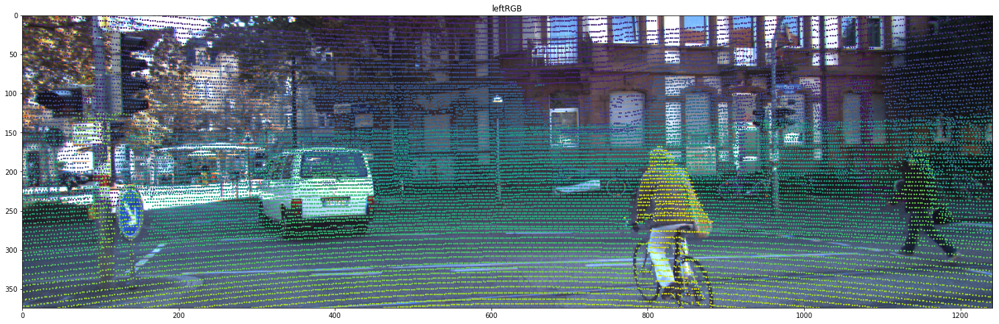

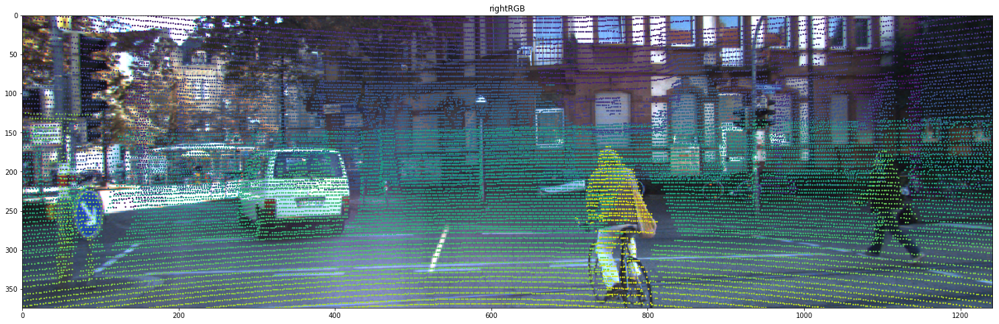

In [53]:
N_frames = len(list(dataset.velo))
velo_reproj_list = []
for i in range(N_frames):
    velo = list(dataset.velo)[i] # [N, 4]
    # project the points to the camera
    velo = velo[:, :3]
    velo_reproj = homo_np(velo)
    velo_reproj_list.append(velo_reproj)

    for cam_iter, cam in enumerate(['leftRGB', 'rightRGB']):
        P_rect = P_rects[cam] # P_rect_0[0-3]: 3x4 projection matrix after rectification; the reprojection matrix in MV3D
        P_velo2im = np.dot(np.dot(P_rect, R_cam2rect), velo2cam) # 4*3

        velo_pts_im = np.dot(P_velo2im, velo_reproj.T).T # [*, 3]
        velo_pts_im[:, :2] = velo_pts_im[:,:2] / velo_pts_im[:,2][..., np.newaxis]

    #     velo_pts_im_list.append(velo_pts_im.copy())

        # check if in bounds
        # use minus 1 to get the exact same value as KITTI matlab code
        velo_pts_im[:, 0] = np.round(velo_pts_im[:,0]) - 1
        velo_pts_im[:, 1] = np.round(velo_pts_im[:,1]) - 1
        val_inds = (velo_pts_im[:, 0] >= 0) & (velo_pts_im[:, 1] >= 0)
        val_inds = val_inds & (velo_pts_im[:,0] < im_shape[1]) & (velo_pts_im[:,1] < im_shape[0])
        velo_pts_im = velo_pts_im[val_inds, :]
        
        if i == 0:
            plt.figure(figsize=(30, 8))
            plt.imshow(dataset_rgb[i][cam_iter])
            plt.scatter(velo_pts_im[:, 0].astype(np.int), velo_pts_im[:, 1].astype(np.int), s=2, c=1./velo_pts_im[:, 2])
            plt.xlim(0, im_shape[1]-1)
            plt.ylim(im_shape[0]-1, 0)
            plt.title(cam)
            plt.show()

# Left/right setting
## Rectified cameras and points

[[721.5377   0.     609.5593  44.8573]
 [  0.     721.5377 172.854    0.2164]
 [  0.       0.       1.       0.0027]]
[[ 721.5377    0.      609.5593 -339.5242]
 [   0.      721.5377  172.854     2.1999]
 [   0.        0.        1.        0.0027]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
[[ 0.0598]
 [-0.0004]
 [ 0.0027]]
[[-0.4729]
 [ 0.0024]
 [ 0.0027]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]] [[-0.5327]
 [ 0.0028]
 [-0.    ]]


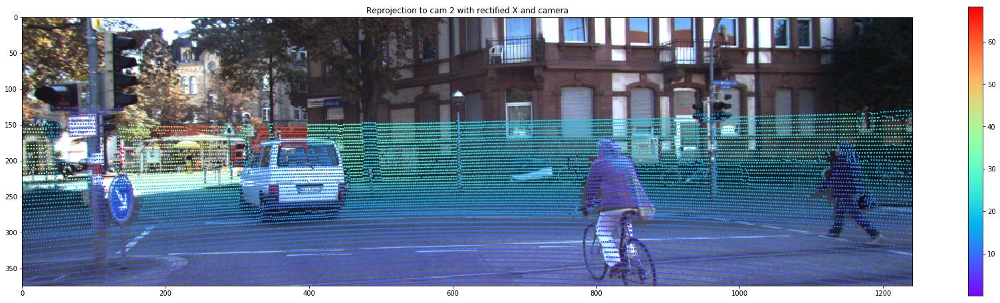

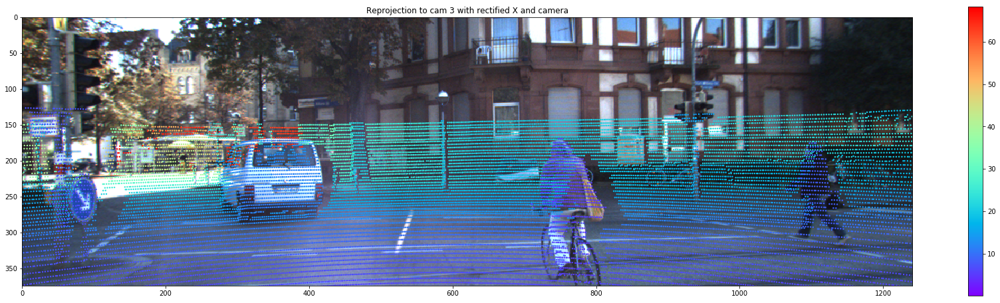

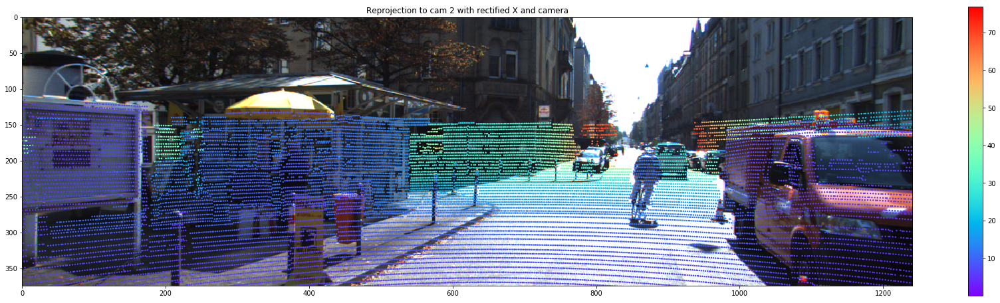

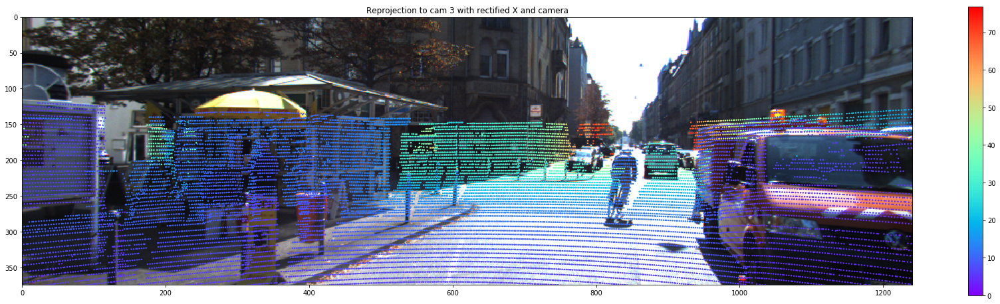

In [61]:
print(dataset.calib.P_rect_20)
print(dataset.calib.P_rect_30)
K = dataset.calib.P_rect_20[:3, :3]
K_th = torch.from_numpy(K)
M1_gt = np.matmul(np.linalg.inv(K), dataset.calib.P_rect_20)
M2_gt = np.matmul(np.linalg.inv(K), dataset.calib.P_rect_30)

t1_gt = M1_gt[:, 3:4]
t2_gt = M2_gt[:, 3:4]
R1_gt = M1_gt[:, :3]
R2_gt = M2_gt[:, :3]
print(R1_gt)
print(R2_gt)
print(t1_gt)
print(t2_gt)

R1t1_gt = np.vstack((np.hstack((R1_gt, t1_gt)), np.array([0., 0., 0., 1.], dtype=np.float64)))
delta_Rt_gt = np.matmul(np.hstack((R2_gt, t2_gt)), np.linalg.inv(R1t1_gt))
delta_R_gt = delta_Rt_gt[:, :3]
delta_t_gt = delta_Rt_gt[:, 3:4]
print(delta_R_gt, delta_t_gt)
t_gt_x = torch_skew_symmetric(torch.from_numpy(delta_t_gt).float())
E_gt_th = torch.matmul(t_gt_x, torch.eye(3)).to(torch.float64)
F_gt_th = torch.matmul(torch.matmul(torch.inverse(K_th).t(), E_gt_th), torch.inverse(K_th))

def rectify(velo_reproj, im_l, im_r, visualize=False):
    val_inds_list = []

    X_homo = np.dot(np.dot(R_cam2rect, velo2cam), velo_reproj.T) # 4*N
    X_homo_rect = np.matmul(R1t1_gt, X_homo)
    X_rect = X_homo_rect[:3, :] / X_homo_rect[3:4, :]

    front_mask = X_rect[-1, :]>0
#     print(X_rect.shape)
    X_rect = X_rect[:, front_mask]
#     print(X_rect.shape)
    X_homo_rect = X_homo_rect[:, front_mask]
    # velo_pts_im_list[0] = velo_pts_im_list[0][front_mask, :]
    # velo_pts_im_list[1] = velo_pts_im_list[1][front_mask, :]

    # Plot with recfitied X and R, t
    x1_homo = np.matmul(K, np.matmul(np.hstack((np.eye(3), np.zeros((3, 1)))), X_homo_rect)).T
    x1 = x1_homo[:, 0:2]/x1_homo[:, 2:3]
    if visualize:
        plt.figure(figsize=(30, 8))
        plt.imshow(im_l)
        val_inds = scatter_xy(x1, x1_homo[:, 2], im_shape, 'Reprojection to cam 2 with rectified X and camera', new_figure=False)
    else:
        val_inds = within(x1[:, 0], x1[:, 1], im_shape[1], im_shape[0])
#     print(val_inds.shape)
    val_inds_list.append(val_inds)

    x2_homo = np.matmul(K, np.matmul(np.hstack((delta_R_gt, delta_t_gt)), X_homo_rect)).T
    x2 = x2_homo[:, :2]/x2_homo[:, 2:3]
    if visualize:
        plt.figure(figsize=(30, 8))
        plt.imshow(im_r)
        val_inds = scatter_xy(x2, x2_homo[:, 2], im_shape, 'Reprojection to cam 3 with rectified X and camera', new_figure=False)
    else:
        val_inds = within(x1[:, 0], x1[:, 1], im_shape[1], im_shape[0])
#     print(val_inds.shape)
    val_inds_list.append(val_inds)

    val_inds_both = val_inds_list[0] & val_inds_list[1]
#     print(val_inds_both.shape)
    val_idxes = [idx for idx in range(val_inds_both.shape[0]) if val_inds_both[idx]] # within indexes
    return val_idxes, X_rect

val_idxes_list = []
X_rect_list = []
for i in range(N_frames):
    val_idxes, X_rect = rectify(velo_reproj_list[i], dataset_rgb[i][0], dataset_rgb[i][1], visualize=(i%100==0))
    val_idxes_list.append(val_idxes)
    X_rect_list.append(X_rect)

# Test camera transformation matrixs

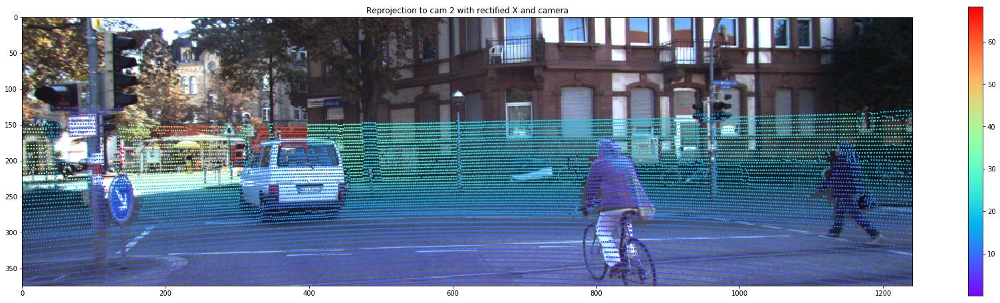

0.0
[[ 1. -0.  0. -0.]
 [ 0.  1. -0.  0.]
 [ 0. -0.  1.  0.]]


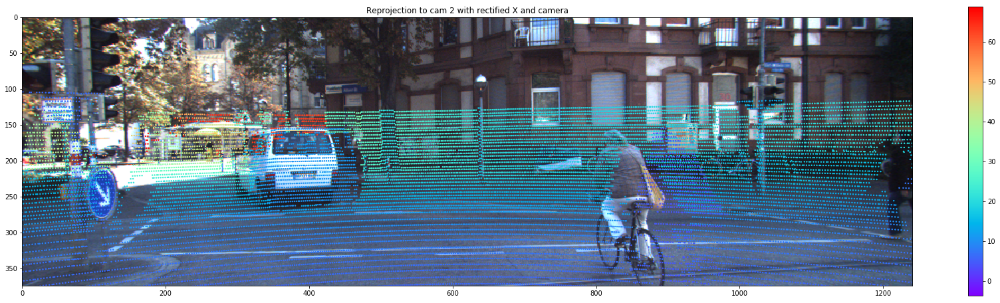

2.6813316336012916
[[ 0.9992 -0.0021  0.0404 -0.0269]
 [ 0.0031  0.9997 -0.0235  0.0465]
 [-0.0403  0.0236  0.9989 -0.9918]]


In [253]:
test_frame_idx = 3
for i in [0, test_frame_idx]:
    X_rect = X_rect_list[0]
    Rt1 = scene_data['pose'][i]
    x1_homo = np.matmul(K, np.matmul(Rt1, homo_np(X_rect.T).T)).T
    x1 = x1_homo[:, 0:2]/x1_homo[:, 2:3]
    plt.figure(figsize=(30, 8))
    plt.imshow(dataset_rgb[i][0])
    val_inds = scatter_xy(x1, x1_homo[:, 2], im_shape, 'Reprojection to cam 2 with rectified X and camera', new_figure=False)
    import dsac_tools.utils_F as utils_F
    print(utils_F.rot12_to_angle_error(np.eye(3), Rt1[:, :3]))
    
    print(Rt1)

## Keypoint detection and matching

# kps: 3420, descriptors: (3420, 128)
# kps: 3421, descriptors: (3421, 128)


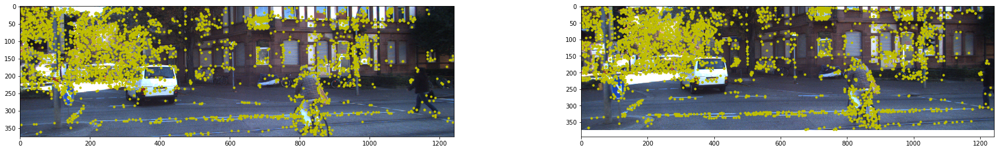

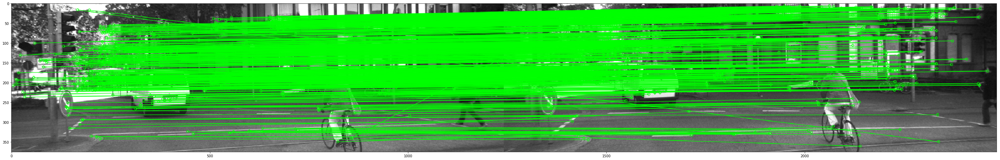

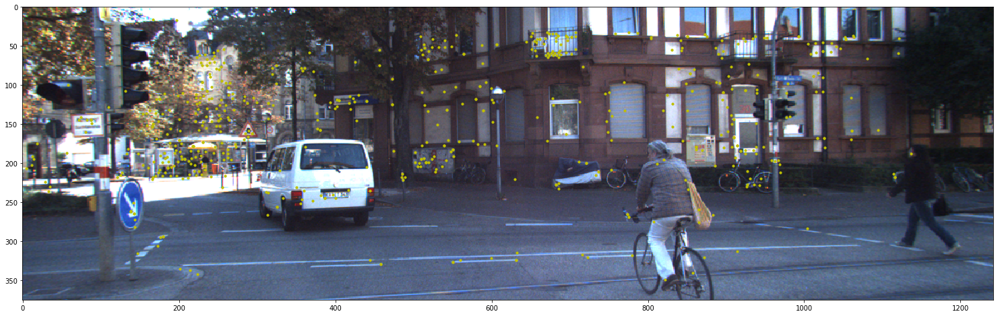

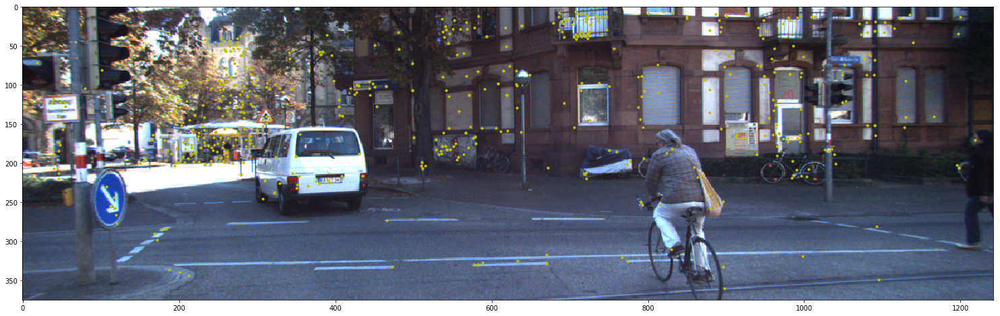

In [254]:
%reload_ext autoreload
%autoreload 2

def show_kp(img, x, scale=1):
    plt.figure(figsize=(30*scale, 8*scale))
    plt.imshow(img)
    plt.scatter(x[:, 0], x[:, 1], s=10, marker='o', c='y')
    plt.show()

import cv2
MIN_MATCH_COUNT = 10

# img1 = cv2.imread('0000000000_0.png',0) # queryImage
img1_rgb = np.array(dataset_rgb[0][0])
img1 = cv2.cvtColor(img1_rgb, cv2.COLOR_BGR2GRAY)
img2_rgb = np.array(dataset_rgb[test_frame_idx][0])
img2 = cv2.cvtColor(img2_rgb, cv2.COLOR_BGR2GRAY)

# Initiate SIFT detector
# pip install opencv-python==3.4.2.16, opencv-contrib-python==3.4.2.16
# https://www.pyimagesearch.com/2015/07/16/where-did-sift-and-surf-go-in-opencv-3/
sift = cv2.xfeatures2d.SIFT_create()

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1,None)
print("# kps: {}, descriptors: {}".format(len(kp1), des1.shape))
x1_all = np.array([p.pt for p in kp1])
# show_kp(img1_rgb, x1_all, 0.5)

kp2, des2 = sift.detectAndCompute(img2,None)
print("# kps: {}, descriptors: {}".format(len(kp2), des2.shape))
x2_all = np.array([p.pt for p in kp2])
# show_kp(img2_rgb, x2_all, 0.5)

plt.figure(figsize=(30, 4))
plt.subplot(121)
plt.imshow(img1_rgb)
plt.scatter(x1_all[:, 0], x1_all[:, 1], s=10, marker='o', c='y')
plt.subplot(122)
plt.imshow(img2_rgb)
plt.scatter(x2_all[:, 0], x2_all[:, 1], s=10, marker='o', c='y')
plt.show()

FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2) # another option is https://github.com/MagicLeapResearch/SuperPointPretrainedNetwork/blob/master/demo_superpoint.py#L309
# store all the good matches as per Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                   singlePointColor = None,
                   matchesMask = None, # draw only inliers
                   flags = 2)

img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)

plt.figure(figsize=(60, 8))
plt.imshow(img3, 'gray')
plt.show()

x1 = x1_all[[mat.queryIdx for mat in good], :]
plt.figure(figsize=(30, 8))
plt.imshow(img1_rgb)
plt.scatter(x1[:, 0], x1[:, 1], s=10, marker='o', c='y')
plt.show()

x2 = x2_all[[mat.trainIdx for mat in good], :]
plt.figure(figsize=(30, 8))
plt.imshow(img2_rgb)
plt.scatter(x2[:, 0], x2[:, 1], s=10, marker='o', c='y')
plt.show()

assert x1.shape == x2.shape

## Plot epipolar constraint by OpenCV and Rui's implementations

[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]


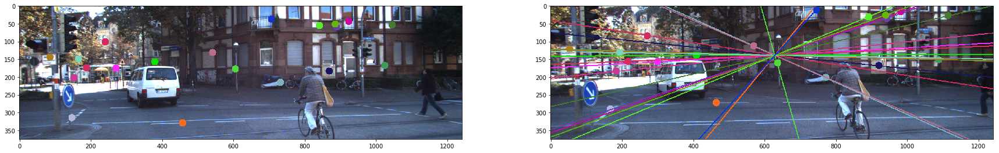

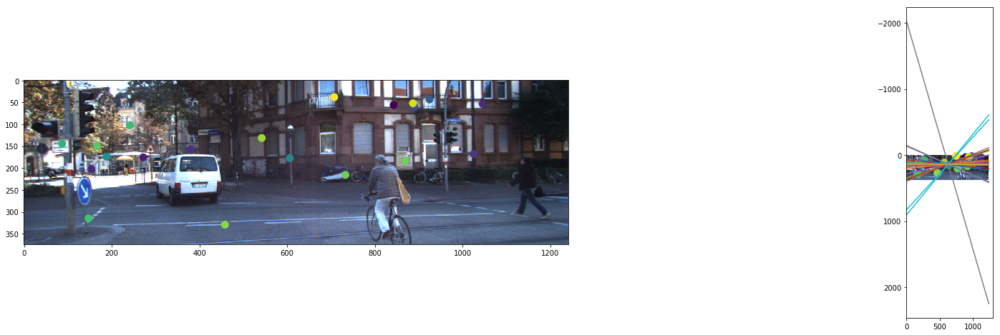

In [255]:
def E_F_from_Rt(R, t, K):
    K_th = torch.from_numpy(K).to(torch.float64)
    R_th = torch.from_numpy(R).to(torch.float64)
    t_th = torch.from_numpy(t).to(torch.float64)
    t_gt_x = torch_skew_symmetric(t_th)
#     print(t_gt_x, R_th)
    E_gt_th = torch.matmul(t_gt_x, R_th)
    F_gt_th = torch.matmul(torch.matmul(torch.inverse(K_th).t(), E_gt_th), torch.inverse(K_th))
    return E_gt_th, F_gt_th

E_gt_th, F_gt_th = E_F_from_Rt(scene_data['pose'][test_frame_idx][:, :3], scene_data['pose'][test_frame_idx][:, 3:4], K)    
F_gt = F_gt_th.numpy()

R2s, t2s, M2s = utils_F.get_M2s(E_gt_th)
print(E_gt_th.numpy())
# print(scene_data['pose'][test_frame_idx][:, :3])
# print(R2s[0].numpy())
# print(scene_data['pose'][test_frame_idx][:, 3:4])
# print(t2s[0].numpy())

## By OpenCV
def drawlines(img1,img2,lines,pts1,pts2):
    ''' img1 - image on which we draw the epilines for the points in img2
        lines - corresponding epilines '''
    r,c = img1.shape[:2]
#     img1 = cv2.cvtColor(img1,cv2.COLOR_GRAY2BGR)
#     img2 = cv2.cvtColor(img2,cv2.COLOR_GRAY2BGR)
    for r,pt1,pt2 in zip(lines,pts1,pts2):
        color = tuple(np.random.randint(0,255,3).tolist())
        x0,y0 = map(int, [0, -r[2]/r[1] ])
        x1,y1 = map(int, [c, -(r[2]+r[0]*c)/r[1] ])
        img1 = cv2.line(img1, (x0,y0), (x1,y1), color,2)
        img1 = cv2.circle(img1,tuple(pt1),10,color,-1)
        img2 = cv2.circle(img2,tuple(pt2),10,color,-1)
    return img1,img2

import random
random.seed(10)
N_points = 20
random_idx = random.sample(range(x1.shape[0]), N_points)
# random_idx = mask_index
x1_sample = x1[random_idx, :]
x2_sample = x2[random_idx, :]

lines2 = cv2.computeCorrespondEpilines(x1_sample.reshape(-1,1,2).astype(int), 1,F_gt)
lines2 = lines2.reshape(-1,3)
img3,img4 = drawlines(img2_rgb.copy(), img1_rgb.copy(), lines2, x2_sample.astype(int), x1_sample.astype(int))

plt.figure(figsize=(30, 8))
plt.subplot(121),plt.imshow(img4)
plt.subplot(122),plt.imshow(img3)
plt.show()

## By Rui
x1_sample_homo = homo_np(x1_sample)
x2_sample_homo = homo_np(x2_sample)
right_P = np.matmul(F_gt, x1_sample_homo.T)
right_epipolar_x = np.tile(np.array([[0], [1]]), N_points) * im_shape[1]
# Using the eqn of line: ax+by+c=0; y = (-c-ax)/b, http://ai.stanford.edu/~mitul/cs223b/draw_epipolar.m
right_epipolar_y = (-right_P[2:3, :] - right_P[0:1, :] * right_epipolar_x) / right_P[1:2, :]

colors = np.random.rand(x2_sample.shape[0])
plt.figure(figsize=(30, 8))
plt.subplot(121)
plt.imshow(img1_rgb)
plt.scatter(x1_sample[:, 0], x1_sample[:, 1], s=100, c=colors)
plt.subplot(122)
plt.imshow(img2_rgb)
plt.plot(right_epipolar_x, right_epipolar_y)
plt.scatter(x2_sample[:, 0], x2_sample[:, 1], s=100, c=colors)
plt.show()

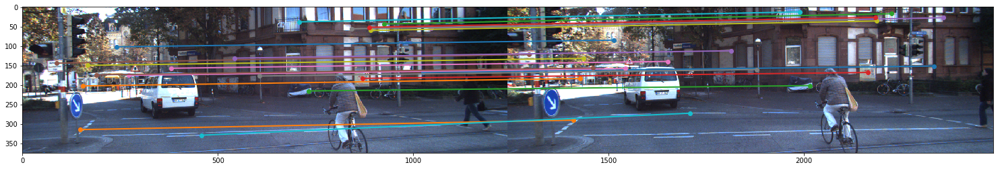

In [256]:
def get_cmap(n, name='hsv'):
    '''Returns a function that maps each index in 0, 1, ..., n-1 to a distinct 
    RGB color; the keyword argument name must be a standard mpl colormap name.'''
    return plt.cm.get_cmap(name, n)

from itertools import cycle
cycol = cycle('bgrcmk')

def draw_corr(im1, im2, x1, x2, linewidth):
    # im1 = img1_rgb
    # im2 = img2_rgb
    # x1 = x1_sample
    # x2 = x2_sample
    x2_copy = x2.copy()
    x2_copy[:, 0] = x2_copy[:, 0] + im_shape[1]
    im12 = np.hstack((im1, im2))

    plt.figure(figsize=(30, 4))
    plt.imshow(im12)
    plt.plot(np.vstack((x1[:, 0], x2_copy[:, 0])), np.vstack((x1[:, 1], x2_copy[:, 1])), marker='o', linewidth=linewidth)
    plt.show()
    
draw_corr(img1_rgb, img2_rgb, x1_sample, x2_sample, 2)

## Compute the Sampson distance
Multiplt View Geometry book, pg. 287, equ. 11.9, also https://github.com/marktao99/python/blob/master/CVP/samples/sfm.py#L216 ![image.png](https://ws3.sinaimg.cn/large/006tNc79ly1fzxju5m01oj3392070q4o.jpg)

[   0.2037   44.0133    0.9081    0.3166    0.1353    4.9955    0.0183
    0.1665    0.0247 1044.8554    0.0196    0.9512    0.0546    0.0029
    1.2065    0.0373    0.0588    1.1323    0.0564    0.5198]


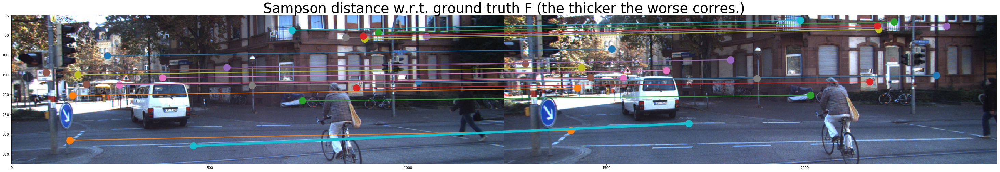

In [257]:
x1_sample_homo_th = torch.from_numpy(x1_sample_homo)
x2_sample_homo_th = torch.from_numpy(x2_sample_homo)
F_gt_th_scale = 0.01 * F_gt_th # to show this distance is invariant to scaling the F
nominator = (torch.diag(torch.matmul(torch.matmul(x2_sample_homo_th, F_gt_th_scale), x1_sample_homo_th.t())))**2
Fx1 = torch.mm(F_gt_th_scale, x1_sample_homo_th.t())
Fx2 = torch.mm(F_gt_th_scale, x2_sample_homo_th.t())
denom = Fx1[0]**2 + Fx1[1]**2 + Fx2[0]**2 + Fx2[1]**2
error = nominator/denom
print(error.numpy())

def draw_corr_widths(im1, im2, x1, x2, linewidth, title='', rescale=True):
    # im1 = img1_rgb
    # im2 = img2_rgb
    # x1 = x1_sample
    # x2 = x2_sample
    x2_copy = x2.copy()
    x2_copy[:, 0] = x2_copy[:, 0] + im_shape[1]
    im12 = np.hstack((im1, im2))

    plt.figure(figsize=(60, 8))
    plt.imshow(im12)
    for i in range(x1.shape[0]):
        if rescale:
            width = 5 if linewidth[i]<2 else 10
        else:
            width = linewidth[i]
        plt.plot(np.vstack((x1[i, 0], x2_copy[i, 0])), np.vstack((x1[i, 1], x2_copy[i, 1])), linewidth=width, marker='o', markersize=20)
    plt.title(title, {'fontsize':40})
    plt.show()
draw_corr_widths(img1_rgb, img2_rgb, x1_sample, x2_sample, error.numpy()/np.max(error.numpy())*5+2, 'Sampson distance w.r.t. ground truth F (the thicker the worse corres.)', False)

# DSAC

[0.     0.     0.     0.     0.     0.     0.0001 0.0001 0.0002 0.0003]


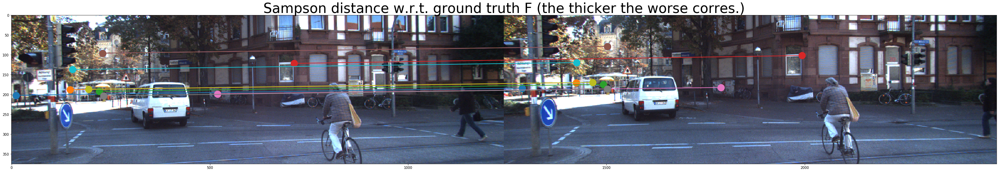

+++ [[-0.0014 -0.9932 -0.0201]
 [ 0.9874 -0.0114  0.0842]
 [ 0.0431 -0.0478  0.0027]]
[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]
[[ 0.9993 -0.0074  0.0376  0.0475]
 [ 0.0083  0.9997 -0.0229  0.0436]
 [-0.0374  0.0232  0.999  -0.9979]]
[[-0.9912  0.0093 -0.1323  0.0475]
 [-0.0008 -0.998  -0.0639  0.0436]
 [-0.1326 -0.0633  0.9891 -0.9979]]
Error! 2 of qualified [R|t] found!
The rotation error (degree):  2.5642334152113566
--- [[-0.     -0.      0.0003]
 [ 0.     -0.     -0.0011]
 [-0.0003  0.0011 -0.0292]]
[[ 0.      0.     -0.0003]
 [-0.      0.      0.0011]
 [ 0.0003 -0.0012  0.0292]]


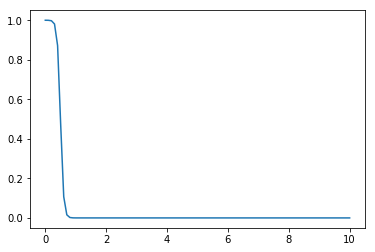

In [260]:
%reload_ext autoreload
%autoreload 2
np.set_printoptions(precision=4, suppress=True)

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC

from scipy.io import savemat

# Validation: use best 10 corres with smalles Sampson distance to GT F to compute E and F
errors = utils_F.sampson_dist(F_gt_th, torch.from_numpy(x1).to(torch.float64), torch.from_numpy(x2).to(torch.float64), False)
sort_index = np.argsort(errors.numpy())
mask_index = sort_index[:10]
print(errors[mask_index].numpy())

draw_corr_widths(img1_rgb, img2_rgb, x1[mask_index, :], x2[mask_index, :], np.zeros(x2[mask_index, :].shape[0])+2, 'Sampson distance w.r.t. ground truth F (the thicker the worse corres.)', False)
E_est_th = utils_F.E_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]),K_th)
print('+++', (E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

M2_list = _E_to_Ms(E_est_th)

F_est_th = utils_F.F_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]))
print('---', (F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
print(F_gt)

inlier_beta = 20
inlier_thresh = 0.5 # HOW TO SET THRES?
a = torch.linspace(0, 10, 100)
b = 1 - torch.sigmoid(inlier_beta * (a - inlier_thresh))
plt.plot(a.numpy(), b.numpy())
plt.show()

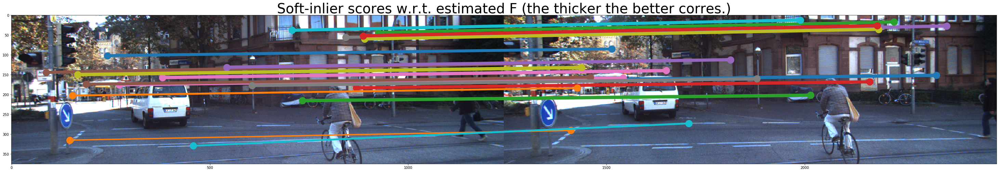

[[-0.0025 -0.9924  0.0018]
 [ 0.9912 -0.002   0.0678]
 [ 0.0211 -0.0281  0.0015]]
[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]
[[-0.9953  0.0025 -0.0965  0.0283]
 [-0.0006 -0.9998 -0.0195  0.0214]
 [-0.0965 -0.0193  0.9951 -0.9994]]
[[ 0.9992 -0.0026  0.04    0.0283]
 [ 0.0035  0.9997 -0.0232  0.0214]
 [-0.04    0.0233  0.9989 -0.9994]]
Error! 2 of qualified [R|t] found!
The rotation error (degree):  2.6585283752534763


In [259]:
%reload_ext autoreload
%autoreload 2

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC
import dsac_tools.utils_F as utils_F
import torch

np.set_printoptions(precision=4, suppress=True)

N_hypotheses = 10000
inlierthreshold = 0.05
inlierbeta = 100.
inlieralpha = 0.5

loss = HLoss()
dsac = DSAC(N_hypotheses, inlierthreshold, inlierbeta, inlieralpha, loss)
N_scores = dsac(torch.from_numpy(x1), torch.from_numpy(x2), F_gt_th)
N_scores_np = N_scores.numpy()
N_scores_np = N_scores_np/np.max(N_scores_np)

draw_corr_widths(img1_rgb, img2_rgb, x1_sample, x2_sample, N_scores_np[random_idx]*10+1, 'Soft-inlier scores w.r.t. estimated F (the thicker the better corres.)', False)

F_est_th = dsac.best_H
best_corres_idx = dsac.best_corres_idx
# print((F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
# print(F_gt)

E_est_th = utils_F.F_to_E(F_est_th, K_th)
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

def _E_to_Ms(E_est_th):
    R2s, t2s, M2s = utils_F.get_M2s(E_est_th)
    # print([M2.numpy() for M2 in M2s])

    R1 = np.eye(3)
    t1 = np.zeros((3, 1))
    M1 = np.hstack((R1, t1))

    cheirality_checks = []
    M2_list = []
    for Rt_idx, M2 in enumerate(M2s):
        M2 = M2.numpy()
        R2 = M2[:, :3]
        t2 = M2[:, 3:4]

        X_tri_homo = cv2.triangulatePoints(np.matmul(K, M1), np.matmul(K, M2), x1[best_corres_idx, :].T, x2[best_corres_idx, :].T)
        X_tri = X_tri_homo[:3, :]/X_tri_homo[-1, :]
        cheirality1 = np.matmul(R1[2:3, :], (X_tri-t1))

        X_tri_cam3 = np.matmul(R2, X_tri) + t2
        cheirality2 = np.matmul(R2[2:3, :], (X_tri-t2))
        cheirality_check = np.min(cheirality1)>0 and np.min(cheirality2)>0
        cheirality_checks.append(cheirality_check)
        if cheirality_check:
            print(M2)
            M2_list.append(M2)

    if np.sum(cheirality_checks)==1:
        Rt_idx = cheirality_checks.index(True)
        print('The %d_th Rt meets the Cheirality Condition! with [R|t]:'%Rt_idx)
        print(M2s[Rt_idx].numpy())
    else:
        print('Error! %d of qualified [R|t] found!'%np.sum(cheirality_checks))
    
    if M2_list:
        R2 = M2_list[0][:, :3]
        error_R = min([utils_F.rot12_to_angle_error(R2.numpy(), delta_R_gt) for R2 in R2s])
        print('The rotation error (degree): ', error_R)
    
    return M2_list

M2_list = _E_to_Ms(E_est_th)

# With SuperPoint corres.

In [ ]:
sp_results = np.load('dsac_tools/data/0000000000.npz')
print(x.files)
x1_sp = sp_results['keypoints1']
x2_sp = sp_results['keypoints2']
maches_sp = sp_results['matches']
x1 = maches_sp[:, :2]
x2 = maches_sp[:, 2:4]
print(x1_sp.shape, x2_sp.shape, maches_sp.shape)
print(x1.shape, x2.shape)

draw_corr_widths(img1_rgb, img2_rgb, x1, x2, np.zeros(x1.shape[0])+3, 'SuperPoint detection and correspondence', rescale=False)

errors = utils_F.sampson_dist(F_gt_th, torch.from_numpy(x1).to(torch.float64), torch.from_numpy(x2).to(torch.float64), False)
sort_index = np.argsort(errors.numpy())
mask_index = sort_index[:10]
print(errors[sort_index].numpy())

E_est_th = utils_F.E_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]))
print(E_gt_th.numpy())
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
R2s, t2s, M2s = utils_F.get_M2s(E_est_th)
print(M2s[0].numpy())

error_R = min([utils_F.rot12_to_angle_error(R2.numpy(), delta_R_gt) for R2 in R2s])
print('The rotation error of best 10 corres. w.r.t GT F (degree): ', error_R)

In [ ]:
%reload_ext autoreload
%autoreload 2

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC
import dsac_tools.utils_F as utils_F
import torch

N_hypotheses = 10000
inlierthreshold = 0.05
inlierbeta = 100.
inlieralpha = 0.5

loss = HLoss()
dsac = DSAC(N_hypotheses, inlierthreshold, inlierbeta, inlieralpha, loss)
N_scores = dsac(torch.from_numpy(x1), torch.from_numpy(x2), F_gt_th)
N_scores_np = N_scores.numpy()
N_scores_np = N_scores_np/np.max(N_scores_np)

draw_corr_widths(img1_rgb, img2_rgb, x1, x2, N_scores_np*5, 'Soft-inlier scores w.r.t. estimated F (the thicker the better corres.)', False)

F_est_th = dsac.best_H
best_corres_idx = dsac.best_corres_idx
# print((F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
# print(F_gt)

E_est_th = utils_F.F_to_E(F_est_th, K_th)
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

R2s, t2s, M2s = utils_F.get_M2s(E_est_th)
# print([M2.numpy() for M2 in M2s])

R1 = np.eye(3)
t1 = np.zeros((3, 1))
M1 = np.hstack((R1, t1))

cheirality_checks = []
for Rt_idx, M2 in enumerate(M2s):
    M2 = M2.numpy()
    R2 = M2[:, :3]
    t2 = M2[:, 3:4]
    
    X_tri_homo = cv2.triangulatePoints(np.matmul(K, M1), np.matmul(K, M2), x1[best_corres_idx, :].T, x2[best_corres_idx, :].T)
    X_tri = X_tri_homo[:3, :]/X_tri_homo[-1, :]
    cheirality1 = np.matmul(R1[2:3, :], (X_tri-t1))
    
    X_tri_cam3 = np.matmul(R2, X_tri) + t2
    cheirality2 = np.matmul(R2[2:3, :], (X_tri-t2))
    cheirality_checks.append(np.min(cheirality1)>0 and np.min(cheirality2)>0)
    
    print('===========')
    print(M2)
    print('-----')
    print(cheirality1)
    print('-----')
    print(cheirality2)

if np.sum(cheirality_checks)==1:
    Rt_idx = cheirality_checks.index(True)
    print('The %d_th Rt meets the Cheirality Condition! with [R|t]:'%Rt_idx)
    print(M2s[Rt_idx].numpy())
else:
    print('Error! %d of qualified [R|t] found!'%np.sum(cheirality_checks))

error_R = min([utils_F.rot12_to_angle_error(R2.numpy(), delta_R_gt) for R2 in R2s])
print('The rotation error from RANSAC (degree): ', error_R)